<h1 align="center" style="color:#9c27b0; font-family:Georgia, serif;">
  💎 Diamond Price Analysis & Market Insights
</h1>

<h3 align="center">
  <span style="color:white; background-color:#03a9f4; padding:4px 10px; border-radius:5px;">EDA</span>
  <span style="color:white; background-color:#4caf50; padding:4px 10px; border-radius:5px;">4C Analysis</span>
  <span style="color:white; background-color:#f44336; padding:4px 10px; border-radius:5px;">Price Impact Factors</span>
</h3>

---

### 📌 Introduction

This notebook presents a comprehensive **Exploratory Data Analysis (EDA)** of a detailed **diamond sales dataset**, designed to uncover what drives diamond pricing in the market.

It focuses on analyzing the classic **4Cs of diamonds** — **Cut**, **Color**, **Clarity**, and **Carat Weight** — alongside other characteristics such as:

- 💎 **Polish, Symmetry, and Fluorescence**
- 📏 **Depth %, Table %, Measurements**
- 📐 **Girdle thickness and Culet**
- 📊 **Total Sales Price trends and distributions**

The objective is to extract **actionable business insights** by understanding how these attributes correlate with price, how they interact, and which factors contribute the most to overall valuation.

---

### 📂 What’s Covered

- ✅ Data cleaning and preprocessing of key diamond attributes
- ✅ Visual analysis of **4Cs** and their impact on price
- ✅ Correlation heatmaps for all numeric features
- ✅ Influence of **fluorescence**, **girdle**, and **culet** on pricing
- ✅ Category-wise comparison (cut, color, clarity, symmetry, polish)
- ✅ Interactive **Plotly visualizations** for deep insights

---

### 📈 Data Source

Comprehensive diamond dataset including:

- **Sales price** and physical attributes
- **Grading lab**, **fluorescence**, **symmetry**, and **polish**
- **GIA-style grading terms** and measurements

> 📊 Whether you're a data analyst, gemologist, or curious buyer, this notebook offers a data-driven exploration of what really influences a diamond’s value in today’s market.

---

Dataset : https://www.kaggle.com/code/hrokrin/kaggle-s-largest-dataset-of-diamonds-eda/input

<a id='top'></a>
<div class="list-group" id="list-tab" role="tablist"></div>

## <div style="text-align: left; background-color:#73a5c7; font-family: Trebuchet MS; color: #EEE8A9; padding: 13px; line-height:0.9;border-radius:2px; margin-bottom: 0em; text-align: center; font-size: 25px">Content</div>


* &nbsp; **[ANALYSIS](#ANALYSIS)**
* &nbsp; **[Final Report](#FINAL-REPORT)**

<a id='top'></a>
<div class="list-group" id="list-tab" role="tablist"></div>

# <div style="text-align: left; background-color:#f0e9d5; font-family: Trebuchet MS; border-left: 5px solid #4CAF50;; padding: 13px;  color: #333; line-height:0.9;border-radius:2px; margin-bottom: 0em; text-align: center; font-size: 25px">LOAD LIBRARY & DATASET</div>

In [3]:
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import numpy as np
from scipy.stats import gaussian_kde
from plotly.subplots import make_subplots

In [4]:
data = pd.read_csv("../datasets/diamonds.csv")

In [5]:
data.shape

(219703, 26)

In [6]:
#### to dispaly all feature without wrap in data.head()
pd.set_option('display.max_columns', None)

In [7]:
data.head()

,Unnamed: 0,cut,color,clarity,carat_weight,cut_quality,lab,symmetry,polish,eye_clean,culet_size,culet_condition,depth_percent,table_percent,meas_length,meas_width,meas_depth,girdle_min,girdle_max,fluor_color,fluor_intensity,fancy_color_dominant_color,fancy_color_secondary_color,fancy_color_overtone,fancy_color_intensity,total_sales_price
0,0,Round,E,VVS2,0.09,Excellent,IGI,Very Good,Very Good,unknown,N,unknown,62.7,59.0,2.85,2.87,1.79,M,M,unknown,NaN,unknown,unknown,unknown,unknown,200
1,1,Round,E,VVS2,0.09,Very Good,IGI,Very Good,Very Good,unknown,N,unknown,61.9,59.0,2.84,2.89,1.78,STK,STK,unknown,NaN,unknown,unknown,unknown,unknown,200
2,2,Round,E,VVS2,0.09,Excellent,IGI,Very Good,Very Good,unknown,unknown,unknown,61.1,59.0,2.88,2.90,1.77,TN,M,unknown,NaN,unknown,unknown,unknown,unknown,200
3,3,Round,E,VVS2,0.09,Excellent,IGI,Very Good,Very Good,unknown,unknown,unknown,62.0,59.0,2.86,2.88,1.78,M,STK,unknown,NaN,unknown,unknown,unknown,unknown,200
4,4,Round,E,VVS2,0.09,Very Good,IGI,Very Good,Excellent,unknown,N,unknown,64.9,58.5,2.79,2.83,1.82,STK,STK,unknown,NaN,unknown,unknown,unknown,unknown,200


<a id='top'></a>
<div class="list-group" id="list-tab" role="tablist"></div>

# <div style="text-align: left; background-color:#f0e9d5; font-family: Trebuchet MS; border-left: 5px solid #4CAF50;; padding: 13px;  color: #333; line-height:0.9;border-radius:2px; margin-bottom: 0em; text-align: center; font-size: 25px">DATA OVERVIEW</div>

In [8]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 219703 entries, 0 to 219702
Data columns (total 26 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   Unnamed: 0                   219703 non-null  int64  
 1   cut                          219703 non-null  object 
 2   color                        219703 non-null  object 
 3   clarity                      219703 non-null  object 
 4   carat_weight                 219703 non-null  float64
 5   cut_quality                  219703 non-null  object 
 6   lab                          219703 non-null  object 
 7   symmetry                     219703 non-null  object 
 8   polish                       219703 non-null  object 
 9   eye_clean                    219703 non-null  object 
 10  culet_size                   219703 non-null  object 
 11  culet_condition              219703 non-null  object 
 12  depth_percent                219703 non-null  float64
 13 

In [9]:
data.describe()

,Unnamed: 0,carat_weight,depth_percent,table_percent,meas_length,meas_width,meas_depth,total_sales_price
count,219703.000000,219703.000000,219703.000000,219703.000000,219703.000000,219703.000000,219703.000000,2.197030e+05
mean,109851.747418,0.755176,61.683768,57.747585,5.548853,5.135626,3.285699,6.908062e+03
std,63423.264419,0.845894,9.915266,9.959928,1.763924,1.374529,2.054822,2.595949e+04
min,0.000000,0.080000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000e+02
25%,54925.500000,0.310000,61.200000,57.000000,4.350000,4.310000,2.680000,9.580000e+02
50%,109852.000000,0.500000,62.400000,58.000000,5.060000,4.800000,3.030000,1.970000e+03
75%,164777.500000,1.000000,63.500000,60.000000,6.350000,5.700000,3.630000,5.207000e+03
max,219703.000000,19.350000,98.700000,94.000000,93.660000,62.300000,76.300000,1.449881e+06


In [10]:
def Columns_Info(data):
    """
    Display a table showing the number of unique values for each column in the DataFrame.
    """
    unique_counts = {
        "Column": data.columns,
        "Unique Values": [data[col].nunique() for col in data.columns],
        'Null values': [data[col].isna().sum() for col in data.columns]
    }
    
    result_df = pd.DataFrame(unique_counts)
    display(result_df)
Columns_Info(data)

,Column,Unique Values,Null values
0,Unnamed: 0,219703,0
1,cut,11,0
2,color,11,0
3,clarity,11,0
4,carat_weight,878,0
5,cut_quality,6,0
6,lab,3,0
7,symmetry,5,0
8,polish,5,0
9,eye_clean,5,0


# **Unique value of all parameter and their explaination**

In [11]:
data['cut'].value_counts()

cut
Round               158316
Oval                 13857
Emerald              11091
Pear                  9860
Princess              7050
Radiant               5630
Heart                 4774
Cushion Modified      3984
Marquise              2916
Asscher               1696
Cushion                529
Name: count, dtype: int64

![alt text](Banner_AllShapes_copy.webp)

In [12]:
data['color'].value_counts()

color
E          33103
F          31566
D          30873
G          29184
H          26073
I          22364
J          16898
K          11750
unknown     9162
L           5683
M           3047
Name: count, dtype: int64

![alt text](<Screenshot 2025-09-24 144843.png>)

In [13]:
data['clarity'].value_counts()

clarity
SI1     38627
VS2     38173
VS1     36956
SI2     31105
VVS2    28985
VVS1    27877
IF       9974
I1       6961
I2        944
I3         91
SI3        10
Name: count, dtype: int64

In [14]:
data['cut_quality'].value_counts()

cut_quality
Excellent    124861
unknown       60607
Very Good     34201
Good             28
Fair              5
Ideal             1
Name: count, dtype: int64

### **Lab**

Indicates the grading laboratory that certified the diamond:

- **GIA**: Gemological Institute of America, the most respected and widely recognized lab.
- **IGI**: International Gemological Institute, known for more affordable grading.
- **HRD**: Hoge Raad voor Diamant (Diamond High Council), based in Antwerp, respected in Europe.

> 💡 **Note**: Certification from top labs like GIA generally adds confidence and value to a diamond.


In [15]:
data['lab'].value_counts()

lab
GIA    200434
IGI     15865
HRD      3404
Name: count, dtype: int64

### Symmetry in a diamond refers to how precisely the facets (flat surfaces) of the diamond are aligned, shaped, and placed in relation to one another. Directely corelate with how light pass through diamond and price also.

In [16]:
data['symmetry'].value_counts()

symmetry
Excellent    131619
Very Good     83143
Good           4609
Fair            325
Poor              7
Name: count, dtype: int64

### **Polish**

Refers to the quality of the diamond’s surface finish after cutting:

- **Excellent**: Smoothest finish, no visible polish marks.
- **Very Good**: Minor polish marks not visible to naked eye.
- **Good**: Visible polish lines under magnification.
- **Fair**: Noticeable polish marks, may affect brilliance.
- **Poor**: Significant polish defects impacting appearance.

> 💡 **Note**: Higher polish grades contribute to better sparkle and overall diamond value.


In [17]:
data['polish'].value_counts()

polish
Excellent    175806
Very Good     42323
Good           1565
Fair              7
Poor              2
Name: count, dtype: int64

### **Eye Clean**

Describes whether a diamond appears free of inclusions to the naked eye:

- **Yes**: No visible inclusions, diamond appears clean.
- **Borderline**: Inclusions are barely visible, close to eye-clean.
- **E1**: Slightly included but often still eye-clean depending on viewer.
- **No**: Inclusions visible to the naked eye.
- **unknown**: Not specified.

> 💡 **Note**: Eye-clean diamonds are preferred as they look flawless without magnification.


In [18]:
data['eye_clean'].value_counts()

eye_clean
unknown       156916
Yes            61931
Borderline       515
E1               300
No                41
Name: count, dtype: int64

### **Culet Size Guide**

| Culet Size | Description |
|------------|-------------|
| **None (N)** | No culet facet, pointed tip (**best**) |
| **Very Small (VS)** | Tiny facet, almost invisible |
| **Small (S)** | Small facet, usually not visible |
| **Medium (M)** | Noticeable under magnification |
| **Slightly Large (SL)** | Larger facet, may affect brilliance |
| **Large (L)** | Visible to naked eye, affects sparkle |
| **Very Large (VL)** | Very visible, greatly reduces brilliance |
| **Extremely Large (EL)** | Very large facet, causes dark spot and sparkle loss |

In [19]:
data['culet_size'].value_counts()

culet_size
N          131899
unknown     85740
VS           1345
S             476
M             163
L              58
SL             14
EL              4
VL              4
Name: count, dtype: int64

### **Culet Condition**

Describes the condition of the diamond’s culet facet:

- **Pointed**: Ideal condition with a sharp tip.
- **Chipped**: Small breaks or chips in the culet.
- **Abraded**: Worn or polished down surface.
- **unknown**: Not specified.

> 💡 **Note**: A pointed culet is preferred as chips or abrasion can affect durability and appearance.


In [20]:
data['culet_condition'].value_counts()

culet_condition
unknown    204384
Pointed     15293
Chipped        18
Abraded         8
Name: count, dtype: int64

### **Girdle Minimum Thickness (girdle_min)**

Describes the thinnest point of the diamond’s girdle. Thickness can impact durability and visual appeal.

| Girdle Code | Description           |
|-------------|------------------------|
| **unknown** | Not specified          |
| **M**       | Medium                 |
| **STK**     | Slightly Thick         |
| **TN**      | Thin                   |
| **TK**      | Thick                  |
| **VTK**     | Very Thick             |
| **XTK**     | Extremely Thick        |
| **VTN**     | Very Thin              |
| **XTN**     | Extremely Thin         |
| **STN**     | Slightly Thin          |

> 💡 **Ideal Range**: Thin to Slightly Thick.  
> Too thin may risk chipping; too thick may reduce visual performance.


In [21]:
data['girdle_min'].value_counts()

girdle_min
unknown    83432
M          74421
STK        26335
TN         16744
TK         10353
VTK         4471
XTK         1981
VTN         1650
XTN          292
STN           24
Name: count, dtype: int64

### **Girdle Maximum Thickness (girdle_max)**

Represents the thickest point of the diamond’s girdle. Excessive thickness can add weight without visual benefit.

| Girdle Code | Description           |
|-------------|------------------------|
| **unknown** | Not specified          |
| **STK**     | Slightly Thick         |
| **TK**      | Thick                  |
| **M**       | Medium                 |
| **VTK**     | Very Thick             |
| **XTK**     | Extremely Thick        |
| **TN**      | Thin                   |
| **VTN**     | Very Thin              |
| **XTN**     | Extremely Thin         |
| **STN**     | Slightly Thin          |

> 💡 **Ideal Range**: Medium to Slightly Thick.  
> Too thick adds weight; too thin increases risk of damage.


In [22]:
data['girdle_max'].value_counts()

girdle_max
unknown    84295
STK        70440
TK         25186
M          17977
VTK        12638
XTK         7647
TN          1363
VTN          111
XTN           34
STN           12
Name: count, dtype: int64

### **Fluorescence Color (fluor_color)**

Indicates the color emitted by a diamond when exposed to ultraviolet (UV) light. Fluorescence can affect a diamond’s appearance under certain lighting conditions.

| Fluorescence Color | Description                        |
|---------------------|------------------------------------|
| **unknown**         | Not specified                      |
| **Blue**            | Most common; usually not an issue  |
| **Yellow**          | May cause warmth in appearance     |
| **Green**           | Rare; may slightly affect color    |
| **White**           | Rare; can give a hazy look         |
| **Orange**          | Very rare                          |

> 💡 **Note**: Blue fluorescence is generally considered neutral or even beneficial in some cases, especially in near-colorless diamonds. Other colors are rare and may affect visual appeal.


In [23]:
data['fluor_color'].value_counts()

fluor_color
unknown    203977
Blue        15219
Yellow        400
Green          55
White          42
Orange         10
Name: count, dtype: int64

### **Fluorescence Intensity (fluor_intensity)**

Describes the strength of the diamond’s fluorescence under UV light. Can subtly or noticeably affect appearance depending on intensity.

| Fluorescence Intensity | Description                                  |
|-------------------------|----------------------------------------------|
| **Faint**               | Barely detectable; little to no effect       |
| **Very Slight**         | Extremely weak; almost unnoticeable          |
| **Slight**              | Very weak (rarely used term)                 |
| **Medium**              | Noticeable under UV light                    |
| **Strong**              | Visible effect; may cause haziness in some  |
| **Very Strong**         | Clearly visible; can affect transparency     |
| **unknown**             | Not specified                                |

> 💡 **Note**: Faint to Medium fluorescence typically has no negative impact. Strong or Very Strong may cause a milky or oily appearance in rare cases.


In [24]:
data['fluor_intensity'].value_counts()

fluor_intensity
Faint          38302
Medium         20705
Strong         13243
Very Slight     2729
Very Strong     1093
unknown          128
Slight            12
Name: count, dtype: int64

### **Fancy Color – Dominant Color (fancy_color_dominant_color)**

Indicates the dominant body color of a fancy color diamond. These are rarer than colorless diamonds and often command premium pricing based on hue, saturation, and rarity.

| Dominant Color | Description                                 |
|----------------|---------------------------------------------|
| **unknown**     | Not specified                              |
| **Yellow**      | Most common fancy color                    |
| **Pink**        | Highly sought after, especially vivid pink |
| **Brown**       | More common, often lower in value          |
| **Green**       | Rare, especially pure green                |
| **Orange**      | Rare and desirable in pure tones           |
| **Purple**      | Rare, often mixed with pink                |
| **Gray**        | Subtle and uncommon                        |
| **Blue**        | Extremely rare and valuable                |
| **Chameleon**   | Changes color under different conditions   |
| **Black**       | Opaque diamonds, valued for unique look    |
| **Red**         | Rarest fancy diamond color                 |
| **Other**       | Unclassified or unusual color              |

> 🎨 **Note**: Rarity and value increase significantly with pure, vivid colors — especially Blue, Pink, and Red.


In [25]:
data['fancy_color_dominant_color'].value_counts()

fancy_color_dominant_color
unknown      210539
Yellow         6487
Pink           1369
Brown           531
Green           302
Orange          271
Purple           76
Gray             66
Blue             38
Chameleon        12
Black             6
Red               4
Other             2
Name: count, dtype: int64

### **Fancy Color – Overtone (fancy_color_overtone)**

Represents secondary hue(s) that influence the dominant fancy color in a diamond. Overtones affect the final appearance and can impact value depending on color combinations.

> 🎨 **Note**: The presence and type of overtone can either enhance or detract from the value depending on how it blends with the dominant color.


In [26]:
data['fancy_color_overtone'].value_counts()

fancy_color_overtone
unknown      217665
Brownish        123
Yellowish        78
Orangey          54
Pinkish          51
Greenish         47
Purplish         34
Grayish           1
Name: count, dtype: int64

### **Fancy Color – Secondary Color (fancy_color_secondary_color)**

Refers to an additional hue that appears alongside the dominant color in fancy color diamonds. The secondary color can subtly influence the overall appearance.

> 🎨 **Note**: The impact of secondary colors on value depends on how well they complement the dominant color. Harmonious blends are typically more desirable.


In [27]:
data['fancy_color_secondary_color'].value_counts()

fancy_color_secondary_color
unknown    218641
Brown         306
Yellow        239
Orange        155
Pink          126
Green         105
Purple         81
Gray           36
Blue           11
Violet          2
Red             1
Name: count, dtype: int64

### **Fancy Color Intensity (fancy_color_intensity)**

Describes the strength and saturation of the diamond's fancy color. Intensity affects the diamond’s rarity and value.

| Intensity         | Description                                |
|-------------------|--------------------------------------------|
| **unknown**       | Not specified                              |
| **Fancy**         | Moderate saturation                        |
| **Fancy Intense** | Strong, vivid color                        |
| **Fancy Light**   | Light saturation, subtle color             |
| **Fancy Deep**    | Darker, rich color                         |
| **Fancy Vivid**   | Brightest and most saturated               |
| **Light**         | Very subtle color                          |
| **Faint**         | Barely noticeable color                    |
| **Fancy Dark**    | Dark and muted tone                        |
| **Very Light**    | Extremely subtle color                     |

> 🎨 **Note**: Higher intensity levels like Fancy Vivid and Fancy Intense are typically more valuable due to their strong, desirable color saturation.


In [28]:
data['fancy_color_intensity'].value_counts()

fancy_color_intensity
unknown          210541
Fancy              3447
Fancy Intense      1943
Fancy Light        1288
Fancy Deep          777
Fancy Vivid         714
Light               318
Faint               238
Fancy Dark          238
Very Light          199
Name: count, dtype: int64

In [29]:
data.head()

,Unnamed: 0,cut,color,clarity,carat_weight,cut_quality,lab,symmetry,polish,eye_clean,culet_size,culet_condition,depth_percent,table_percent,meas_length,meas_width,meas_depth,girdle_min,girdle_max,fluor_color,fluor_intensity,fancy_color_dominant_color,fancy_color_secondary_color,fancy_color_overtone,fancy_color_intensity,total_sales_price
0,0,Round,E,VVS2,0.09,Excellent,IGI,Very Good,Very Good,unknown,N,unknown,62.7,59.0,2.85,2.87,1.79,M,M,unknown,NaN,unknown,unknown,unknown,unknown,200
1,1,Round,E,VVS2,0.09,Very Good,IGI,Very Good,Very Good,unknown,N,unknown,61.9,59.0,2.84,2.89,1.78,STK,STK,unknown,NaN,unknown,unknown,unknown,unknown,200
2,2,Round,E,VVS2,0.09,Excellent,IGI,Very Good,Very Good,unknown,unknown,unknown,61.1,59.0,2.88,2.90,1.77,TN,M,unknown,NaN,unknown,unknown,unknown,unknown,200
3,3,Round,E,VVS2,0.09,Excellent,IGI,Very Good,Very Good,unknown,unknown,unknown,62.0,59.0,2.86,2.88,1.78,M,STK,unknown,NaN,unknown,unknown,unknown,unknown,200
4,4,Round,E,VVS2,0.09,Very Good,IGI,Very Good,Excellent,unknown,N,unknown,64.9,58.5,2.79,2.83,1.82,STK,STK,unknown,NaN,unknown,unknown,unknown,unknown,200


In [30]:
Columns_Info(data)

,Column,Unique Values,Null values
0,Unnamed: 0,219703,0
1,cut,11,0
2,color,11,0
3,clarity,11,0
4,carat_weight,878,0
5,cut_quality,6,0
6,lab,3,0
7,symmetry,5,0
8,polish,5,0
9,eye_clean,5,0


<a id='top'></a>
<div class="list-group" id="list-tab" role="tablist"></div>

# <div style="text-align: left; background-color:#f0e9d5; font-family: Trebuchet MS; border-left: 5px solid #4CAF50;; padding: 13px;  color: #333; line-height:0.9;border-radius:2px; margin-bottom: 0em; text-align: center; font-size: 25px">ANALYSIS</div>

In [31]:
data.drop(columns=['Unnamed: 0'], inplace=True)

In [32]:
# Price per carat
data['price_per_carat'] = data['total_sales_price'] / data['carat_weight']
data['price_per_carat'] = data['price_per_carat'].round(2)

In [33]:
# Basic KPIs
print("Average Total Price: $", data['total_sales_price'].mean())
print("Average Price per Carat: $", data['price_per_carat'].mean())
print("Most Common Cut:", data['cut'].mode()[0])
print("Most Common Color:", data['color'].mode()[0])
print("Most Common Clarity:", data['clarity'].mode()[0])


Average Total Price: $ 6908.062206706326
Average Price per Carat: $ 5591.873395128879
Most Common Cut: Round
Most Common Color: E
Most Common Clarity: SI1


In [34]:
fig = px.histogram(
    data, 
    x='total_sales_price', 
    nbins=50, 
    title='Distribution of Diamond Prices',
    opacity=0.75
)
fig.update_layout(
    xaxis_title='Total Sales Price',
    yaxis_title='Count',
    width=800,
    height=500
)
fig.show()


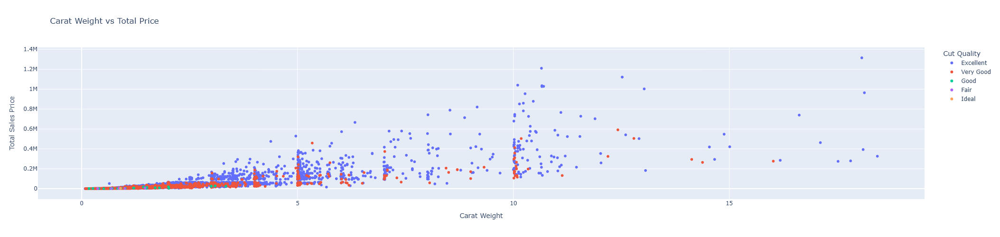

In [53]:
unknown = data[data['cut_quality'] != 'unknown'] ## remove unknown here for better analysis
fig = px.scatter(
    unknown,
    x='carat_weight',
    y='total_sales_price',
    color='cut_quality',
    title='Carat Weight vs Total Price',
    labels={
        'carat_weight': 'Carat Weight',
        'total_sales_price': 'Total Sales Price',
        'cut_quality': 'Cut Quality'
    },
    width=800,
    height=500
)
fig.show()

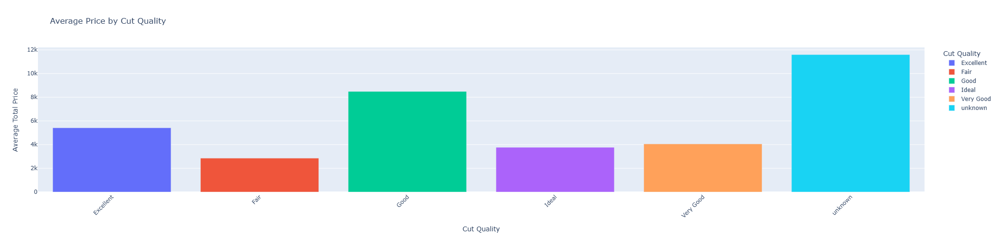

In [36]:
avg_price = data.groupby('cut_quality', as_index=False)['total_sales_price'].mean()

fig = px.bar(
    avg_price,
    x='cut_quality',
    y='total_sales_price',
    title='Average Price by Cut Quality',
    labels={'total_sales_price': 'Average Total Price', 'cut_quality': 'Cut Quality'},
    height=500,
    width=800,
    color='cut_quality'  # Optional: Color by cut quality
)

fig.update_layout(xaxis_tickangle=-45)
fig.show()

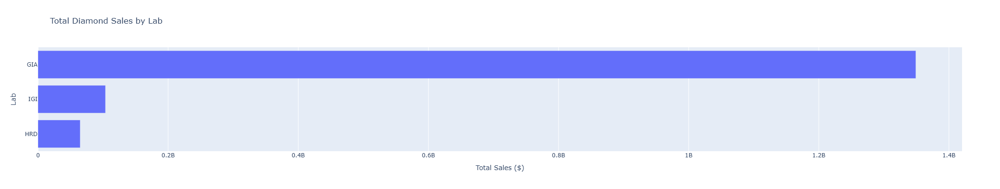

In [37]:
lab_sales = data.groupby('lab', as_index=False)['total_sales_price'].sum().sort_values(by='total_sales_price')

# Create horizontal bar chart
fig = px.bar(
    lab_sales,
    x='total_sales_price',
    y='lab',
    orientation='h',
    title='Total Diamond Sales by Lab',

    labels={'total_sales_price': 'Total Sales ($)', 'lab': 'Lab'},
    height=400,
    width=600
)

fig.update_layout(
    yaxis={'categoryorder': 'total ascending'},  
)
fig.show()

In [38]:
fig = px.scatter(
    data,
    x='carat_weight',
    y='total_sales_price',
    trendline='ols',
    title='Price vs Carat Weight with Trendline',
    labels={'carat_weight': 'Carat Weight', 'total_sales_price': 'Total Sales Price'},
    width=800,
    height=500,
    opacity=0.6
)

fig.show()

In [39]:
fig_symmetry = px.histogram(
    data,
    x='symmetry',
    title='Count of Diamonds by Symmetry',
    labels={'symmetry': 'Symmetry Grade', 'count': 'Count'},
    width=700,
    height=400
)
fig_symmetry.show()

# Count plot for polish
fig_polish = px.histogram(
    data,
    x='polish',
    title='Count of Diamonds by Polish',
    labels={'polish': 'Polish Grade', 'count': 'Count'},
    width=700,
    height=400
)
fig_polish.show()

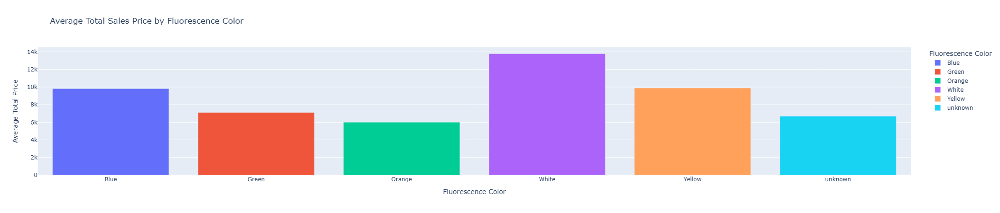

In [40]:
avg_price_fluor_color = data.groupby('fluor_color', as_index=False)['total_sales_price'].mean()

fig_color = px.bar(
    avg_price_fluor_color,
    x='fluor_color',
    y='total_sales_price',
    title='Average Total Sales Price by Fluorescence Color',
    labels={'fluor_color': 'Fluorescence Color', 'total_sales_price': 'Average Total Price'},
    color='fluor_color',
    width=800,
    height=450
)
fig_color.show()

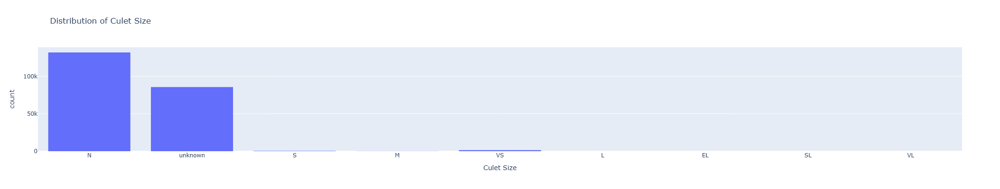

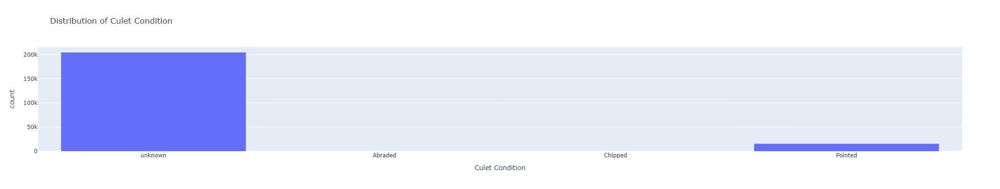

In [41]:
fig_culet_size = px.histogram(
    data,
    x='culet_size',
    title='Distribution of Culet Size',
    labels={'culet_size': 'Culet Size', 'count': 'Count'},
    width=700,
    height=400
)
fig_culet_size.show()

# Culet Condition distribution
fig_culet_condition = px.histogram(
    data,
    x='culet_condition',
    title='Distribution of Culet Condition',
    labels={'culet_condition': 'Culet Condition', 'count': 'Count'},
    width=700,
    height=400
)
fig_culet_condition.show()

In [42]:
avg_price_culet = data.groupby('culet_size', as_index=False)['total_sales_price'].mean()

fig_price_culet = px.bar(
    avg_price_culet,
    x='culet_size',
    y='total_sales_price',
    title='Average Total Sales Price by Culet Size',
    labels={'culet_size': 'Culet Size', 'total_sales_price': 'Average Total Price'},
    width=700,
    height=400,
    color='culet_size'  
)
fig_price_culet.show()


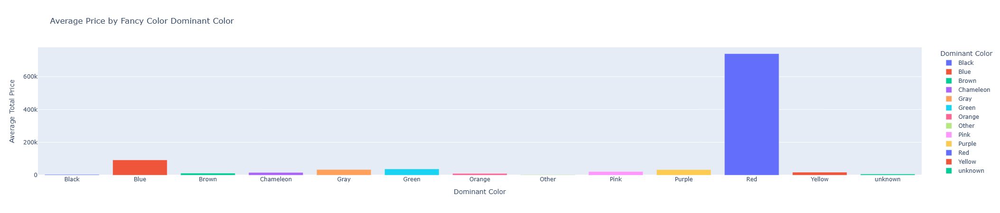

In [57]:
avg_price_color = data.groupby('fancy_color_dominant_color', as_index=False)['total_sales_price'].mean()

fig_avg_price = px.bar(
    avg_price_color,
    x='fancy_color_dominant_color',
    y='total_sales_price',
    title='Average Price by Fancy Color Dominant Color',
    labels={'fancy_color_dominant_color': 'Dominant Color', 'total_sales_price': 'Average Total Price'},
    color='fancy_color_dominant_color',
    width=700,
    height=450,
    
)
fig_avg_price.show()


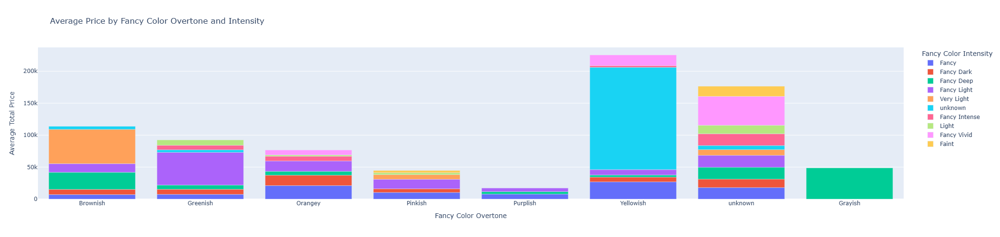

In [44]:
# Aggregate average price by overtone and intensity
avg_price_overtone_intensity = data.groupby(
    ['fancy_color_overtone', 'fancy_color_intensity'], as_index=False
)['total_sales_price'].mean()

fig_stacked = px.bar(
    avg_price_overtone_intensity,
    x='fancy_color_overtone',
    y='total_sales_price',
    color='fancy_color_intensity',
    title='Average Price by Fancy Color Overtone and Intensity',
    labels={
        'fancy_color_overtone': 'Fancy Color Overtone',
        'total_sales_price': 'Average Total Price',
        'fancy_color_intensity': 'Fancy Color Intensity'
    },
    width=800,
    height=500
)
fig_stacked.show()


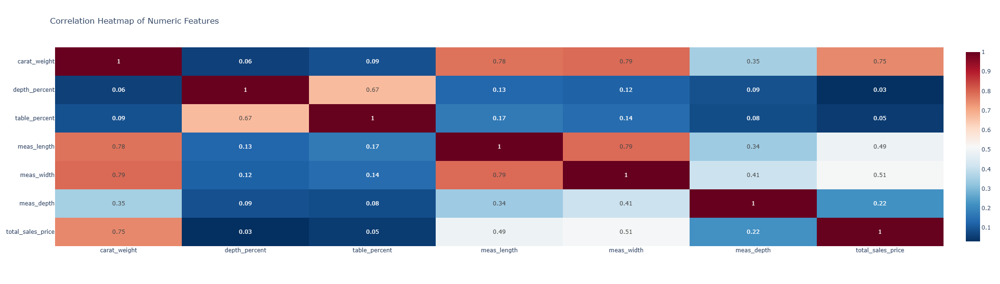

In [45]:
import plotly.express as px

# Select relevant numeric columns
numeric_cols = [
    'carat_weight', 'depth_percent', 'table_percent',
    'meas_length', 'meas_width', 'meas_depth', 'total_sales_price'
]

corr_matrix = data[numeric_cols].corr().round(2)

fig = px.imshow(
    corr_matrix,
    text_auto=True,
    aspect="auto",
    color_continuous_scale='RdBu_r',
    title='Correlation Heatmap of Numeric Features'
)

fig.update_layout(height = 600, width = 1200)
fig.show()


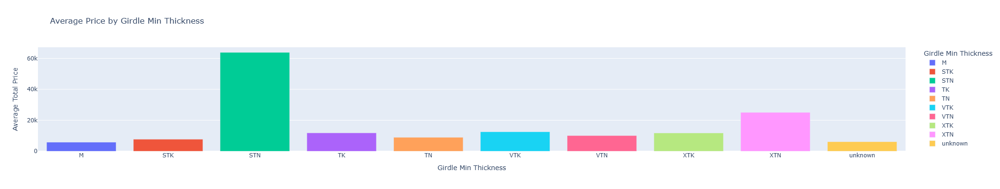

In [46]:
avg_price_girdle_min = data.groupby('girdle_min', as_index=False)['total_sales_price'].mean()

fig_girdle_min = px.bar(
    avg_price_girdle_min,
    
    x='girdle_min',
    y='total_sales_price',
    title='Average Price by Girdle Min Thickness',
    labels={'girdle_min': 'Girdle Min Thickness', 'total_sales_price': 'Average Total Price'},
    color='girdle_min',
    width=700,
    height=400
)
fig_girdle_min.show()


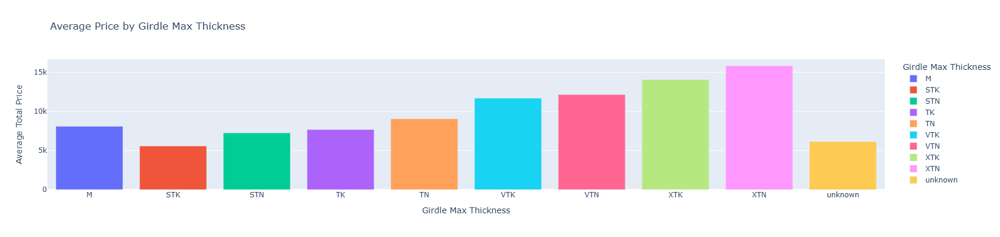

In [47]:
avg_price_girdle_max = data.groupby('girdle_max', as_index=False)['total_sales_price'].mean()

fig_girdle_max = px.bar(
    avg_price_girdle_max,
    x='girdle_max',
    y='total_sales_price',
    title='Average Price by Girdle Max Thickness',
    labels={'girdle_max': 'Girdle Max Thickness', 'total_sales_price': 'Average Total Price'},
    color='girdle_max',
    width=700,
    height=400
)
fig_girdle_max.show()


In [48]:
data

,cut,color,clarity,carat_weight,cut_quality,lab,symmetry,polish,eye_clean,culet_size,culet_condition,depth_percent,table_percent,meas_length,meas_width,meas_depth,girdle_min,girdle_max,fluor_color,fluor_intensity,fancy_color_dominant_color,fancy_color_secondary_color,fancy_color_overtone,fancy_color_intensity,total_sales_price,price_per_carat
0,Round,E,VVS2,0.09,Excellent,IGI,Very Good,Very Good,unknown,N,unknown,62.7,59.0,2.85,2.87,1.79,M,M,unknown,NaN,unknown,unknown,unknown,unknown,200,2222.22
1,Round,E,VVS2,0.09,Very Good,IGI,Very Good,Very Good,unknown,N,unknown,61.9,59.0,2.84,2.89,1.78,STK,STK,unknown,NaN,unknown,unknown,unknown,unknown,200,2222.22
2,Round,E,VVS2,0.09,Excellent,IGI,Very Good,Very Good,unknown,unknown,unknown,61.1,59.0,2.88,2.90,1.77,TN,M,unknown,NaN,unknown,unknown,unknown,unknown,200,2222.22
3,Round,E,VVS2,0.09,Excellent,IGI,Very Good,Very Good,unknown,unknown,unknown,62.0,59.0,2.86,2.88,1.78,M,STK,unknown,NaN,unknown,unknown,unknown,unknown,200,2222.22
4,Round,E,VVS2,0.09,Very Good,IGI,Very Good,Excellent,unknown,N,unknown,64.9,58.5,2.79,2.83,1.82,STK,STK,unknown,NaN,unknown,unknown,unknown,unknown,200,2222.22
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
219698,Round,E,VS1,10.65,Excellent,GIA,Excellent,Excellent,unknown,N,unknown,61.3,58.0,14.06,14.18,8.66,M,STK,unknown,NaN,unknown,unknown,unknown,unknown,1210692,113680.00
219699,Radiant,unknown,VS2,5.17,unknown,GIA,Very Good,Very Good,unknown,unknown,unknown,64.8,65.0,11.55,8.81,5.71,TK,XTK,unknown,NaN,Green,unknown,NaN,Fancy Light,1292500,250000.00
219700,Round,E,VS1,18.07,Excellent,GIA,Excellent,Excellent,unknown,N,unknown,60.2,59.0,17.06,17.10,10.20,TN,M,unknown,NaN,unknown,unknown,unknown,unknown,1315496,72800.00
219701,Princess,unknown,SI2,0.90,unknown,GIA,Good,Good,unknown,N,unknown,70.8,72.0,5.22,4.90,3.47,XTN,VTK,unknown,Faint,Red,unknown,unknown,Fancy,1350000,1500000.00


### 💎 Diamond Price Analysis by the 4Cs (Cut, Color, Clarity, Carat Weight)


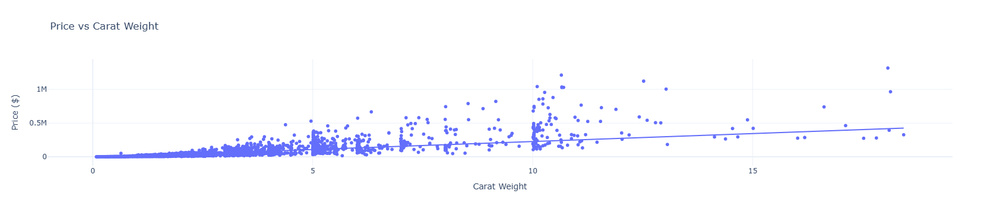

In [49]:
# unknown = data[data['cut_quality'] != 'unknown'] ## remove unknown here for better analysis
fig = px.scatter(
    unknown,
    x='carat_weight',
    y='total_sales_price',
    title='Price vs Carat Weight',
    labels={'carat_weight': 'Carat Weight', 'total_sales_price': 'Price ($)'},
    trendline='ols',  # Add regression line
    template='plotly_white'
)
fig.show()

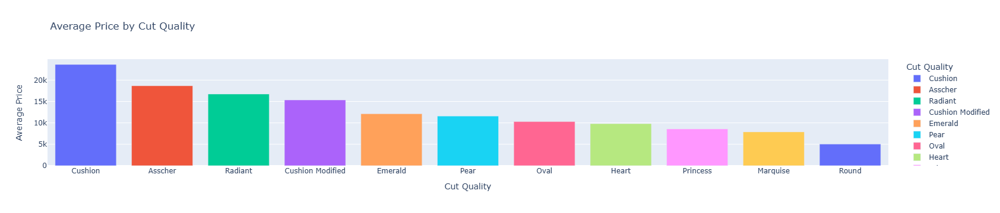

In [50]:
avg_price_cut = data.groupby('cut', as_index=False)['total_sales_price'].mean()

sort_cut = avg_price_cut.sort_values(by='total_sales_price',ascending=False)

fig_cut = px.bar(
    sort_cut,
    x='cut',
    y='total_sales_price',
    title='Average Price by Cut Quality',
    labels={'cut': 'Cut Quality', 'total_sales_price': 'Average Price'},
    color='cut'
)
fig_cut.show()

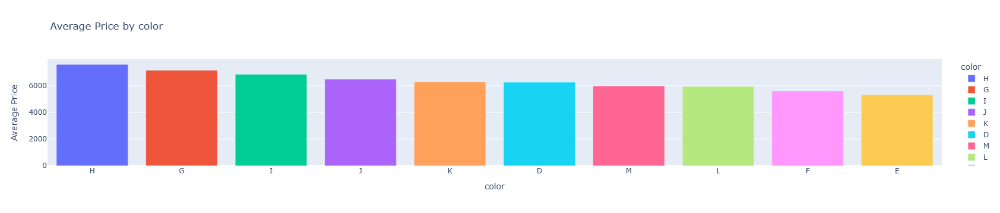

In [51]:
unknown = data[data['color'] != 'unknown'] ## remove unknown here for better analysis

avg_price_color = unknown.groupby('color', as_index=False)['total_sales_price'].mean()
sort_color = avg_price_color.sort_values(by='total_sales_price',ascending=False)

fig_cut = px.bar(
    sort_color,
    x='color',
    y='total_sales_price',
    title='Average Price by color',
    labels={'cut': 'color Quality', 'total_sales_price': 'Average Price'},
    color='color'
)
fig_cut.show()

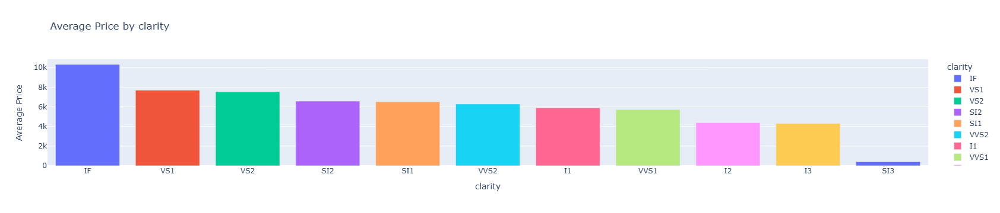

In [52]:

unknown = data[data['clarity'] != 'unknown'] ## remove unknown here for better analysis

avg_price_clarity = unknown.groupby('clarity', as_index=False)['total_sales_price'].mean()
sort_clarity = avg_price_clarity.sort_values(by='total_sales_price',ascending=False)

fig_cut = px.bar(
    sort_clarity,
    x='clarity',
    y='total_sales_price',
    title='Average Price by clarity',
    labels={'cut': 'clarity Quality', 'total_sales_price': 'Average Price'},
    color='clarity'
)
fig_cut.show()

<a id='top'></a>
<div class="list-group" id="list-tab" role="tablist"></div>

# <div style="text-align: left; background-color:#f0e9d5; font-family: Trebuchet MS; border-left: 5px solid #4CAF50;; padding: 13px;  color: #333; line-height:0.9;border-radius:2px; margin-bottom: 0em; text-align: center; font-size: 25px">FINAL REPORT</div>